<a href="https://colab.research.google.com/github/alessiapontiggia/DL-Project/blob/main/Anomaly_Detection_FashionMNIST.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Author



**Student**: Alessia Pontiggia

**ID**: 1892079

**Course**: Deep Learning

**Professor**: Fabrizio Silvestri

# Introduction

In this colab, the *Anomaly Detection (AD) task on the FashionMNIST dataset* is faced.

The main technology used to develop the project is **Pythorch Lightning** and runs over the GPU provided by the Google Colab Free version.

At each section a brief introduction is provided regarding the functions, models and decisions choosen. A more clear and comprehensive explanation can be found in the [paper](https://).

Data, code and papers are grouped up in the [repo Github](https://github.com/alessiapontiggia/DeepLearning-Project/tree/main/data).

# Anomaly Detection

AD is the task of finding those patterns in data that do not adhere to expected norms, given previous observations.

Anomaly detection is then a binary classification between the normal and the anomalous classes.

In general it is very unlikely to apply supervised learning with AD, since defects occur almost never and can be different in type and shape.

In this paper we deal with the FashionMNIST dataset where there's no label for anomalies since it is a anomaly-free dataset.


# Imports

In this section some libraries and functions are imported or installed.


In [2]:
import torch
import torchvision
import torch.nn as nn
from torchvision.transforms import ToTensor, Compose, Normalize
from torchsummary import summary
import torch.nn.functional as F
from torchvision.datasets import FashionMNIST
from torch.utils.data import random_split
from torch.utils.data.dataloader import DataLoader
from torch.utils.data import Subset
from torchsummary import summary
from torchvision.utils import make_grid

In [1]:
import numpy as np
from sklearn.neighbors import KernelDensity
from sklearn import metrics
import matplotlib.pyplot as plt
from copy import deepcopy
%matplotlib inline

In [ ]:
! pip install --quiet "pandas" "ipython[notebook]" "torchvision" "setuptools>65.5.1" "torch>=1.8" "torchmetrics>=0.7" "seaborn" "pytorch-lightning>=1.4"

In [3]:
!pip install pytorch_lightning -qq
!pip install --upgrade wandb -qq

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 722.8/722.8 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.1/731.1 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.5/188.5 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.6/215.6 kB 8.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.5 MB/s eta 0:00:00


In [4]:
import pytorch_lightning as pl
from pytorch_lightning import Trainer, loggers
from torch.utils.tensorboard import SummaryWriter
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks.progress import TQDMProgressBar
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.loggers import CSVLogger

In [ ]:
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

In [ ]:
print("Device:", device)

Device: cuda:0


# FashionMNIST Dataset

FashionMNIST dataset is made up of 60000 samples (50000 for training set and 10000 validation set) and 10000 samples as test set.

Each sample is a 28x28x1 gray image labeled with a number from 0 to 9 representing the category of clothes it belongs to.


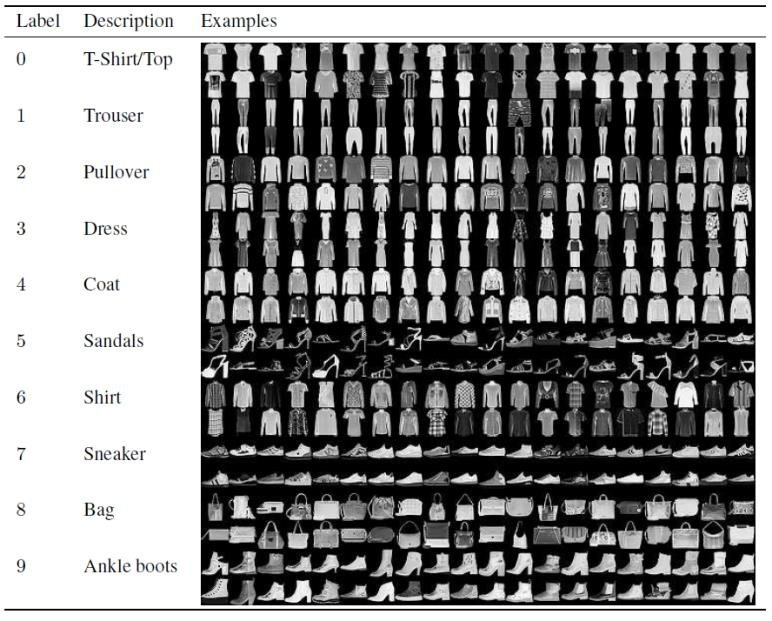

# FashionMNIST DataModule

The Pytorch Lightning procedure follows some steps.

The first one consists in preparing data and dividing it in training, validation and test loaders.

In [ ]:
# parameters used
training_size = 50000
val_size = 10000
train_batch_size = 512
val_test_batch_size = 256
lr=1e-3
weight_decay=1e-5
max_epochs = 10

In [ ]:
dataset = FashionMNIST(root="data/", train=True, download=True, transform = ToTensor())
test_set = FashionMNIST(root="data/", train=False, download=True,transform = ToTensor())
train_ds, val_ds = random_split(dataset, [50000, 10000])
train_loader = DataLoader(train_ds, batch_size=512, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=256)
test_loader = DataLoader(test_set, batch_size=256, shuffle=True)

100%|██████████| 26421880/26421880 [00:01<00:00, 15950364.93it/s]


Extracting data/FashionMNIST/raw/train-images-idx3-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 266542.54it/s]


Extracting data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:00<00:00, 4948332.07it/s]


Extracting data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 12296285.30it/s]


Extracting data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to data/FashionMNIST/raw



In [ ]:
print(dataset.classes)

['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']


In [ ]:
class FashionMNISTDataModule(pl.LightningDataModule):

  def __init__(self, data_dir, batch_size):
    self.data_dir = data_dir
    self.batch_size = batch_size

  def prepare_data(self):
    FashionMNIST(self.data_dir, train = True, download = True)
    FashionMNIST(self.data_dir, train = False, download = True)

  def setup(self, stage=None):
    transform = Compose(
            [
                ToTensor(),
                Normalize((0.5), (0.5)),
            ]
        )
    if stage == "fit":
      dataset = FashionMNIST(
          root=self.data_dir,
          train=True,
          download=False,
          transform=transform)
      self.train_ds, self.val_ds = random_split(dataset, [50000, 10000])
    if stage == "test":
      self.test_ds = FashionMNIST(
          root = self.data_dir,
          train = False,
          download = False,
          transform = transform
      )

  def train_dataloader(self):
    return DataLoader(
        self.train_ds,
        batch_size = self.batch_size,
        shuffle = True
    )


  def val_dataloader(self):
    return DataLoader(
        self.val_ds,
        batch_size = self.batch_size,
        shuffle = True
    )

  def test_dataloader(self):
    return DataLoader(
        self.test_ds,
        batch_size = self.batch_size,
        shuffle = True
    )


# Baseline 1: Convolutional Autoencoder and KDE

This first solution proposed gets inspired by *Robust Anomaly Detection in Images using Adversarial Autoencoders* [1].

## Convolutional Autoencoder

The convolutional autoencoder used is made up of two parts: the encoder, which downsamples the input, and the decoder, which upsamples the compressed input up to its original size.

Let's see first the encoder.

### Encoder

The encoder downsamples the original image in a latent representation also called embedding.

In this case the downsampling process is provided by the convolutional layers.

As shown in the table below, the input image feeds the first convolutional layer which output feeds the second convolutional layer anf finally the third convolutional layer gives the embedding.
Each Conv layer is followed by the relu activation function.


More in details:

---

INPUT IMAGE (28x28x1)


---

CONV LAYER (K=3, S=2, P=1)

RELU

---
OUTPUT IMAGE (14x14x16)


---
CONV LAYER (K=3, S=2, P=1)

RELU

---
OUTPUT IMAGE (7x7x32)


---
CONV LAYER (K=3, S=1, P=0)

RELU


---
OUTPUT EMBEDDING (1x1x64)



The forward pass is the concatenation of the results at each layer.

In [ ]:
class Encoder(nn.Module):
  def __init__(self):
    super().__init__()
    self.conv1 = nn.Conv2d(1, 16, 3, stride=2, padding=1)
    self.conv2 = nn.Conv2d(16, 32, 3, stride=2, padding=1)
    self.conv3 = nn.Conv2d(32, 64, 7)

    self.relu = nn.ReLU()

  def forward(self, x):
    x = self.relu(self.conv1(x))
    x = self.relu(self.conv2(x))
    x = self.relu(self.conv3(x))
    return x

### Decoder

The decoder upsamples the latent representation (embedding) up to the original dimensions of the image.

In this case the upsampling process is provided by the convolutional transpose operation.

As shown in the table below, the embedding feeds the first deconvolutional layer which output feeds the second deconvolutional layer anf finally the third deconvolutional layer gives the reconstruction of the original image.
The first two Deconv layer is followed by the relu activation function, but the third one by the sigmoid activation function


More in details:

---

EMBEDDING (1x1x64)

---

DECONV LAYER (K=7, S=1, P=0)

RELU

---
OUTPUT IMAGE (7x7x32)


---
DECONV LAYER (K=3, S=2, P=1, OP = 1)

RELU

---
OUTPUT IMAGE (14x14x16)


---
DECONV LAYER (K=3, S=2, P=1, OP = 1)

SIGMOID


---
RECONSTRUCTED IMAGE (28x28x1)



In [ ]:
class Decoder(nn.Module):
  def __init__(self):
    super().__init__()

    self.deconv1 = nn.ConvTranspose2d(64, 32, 7)
    self.deconv2 = nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1)
    self.deconv3 = nn.ConvTranspose2d(16, 1, 3, stride=2, padding=1, output_padding=1)

    self.relu = nn.ReLU()
    self.sigmoid = nn.Sigmoid()


  def forward(self, x):
    x = self.relu(self.deconv1(x))
    x = self.relu(self.deconv2(x))
    x = self.sigmoid(self.deconv3(x))
    return x

### Autoencoder

Now, the encoder and decoder are combined in the Autoencoder which also implements some functions for the training process.

In [ ]:
class Autoencoder(pl.LightningModule):
  def __init__(self, encoder, decoder):
    super().__init__()

    self.encoder = encoder
    self.decoder = decoder


    # the forward pass returns the decoded representation of the original image x

  def forward(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

  # in configure_optimizer we set the Adam optimizer and the learning ratio

  def configure_optimizers(self):
    return torch.optim.Adam(self.parameters(), lr=lr, weight_decay=weight_decay)

  def save_images(self, x, output, name):
    grid_top = make_grid(x, nrow=8, padding=10)
    grid_bottom = make_grid(output, nrow=8, padding = 10)
    grid = torch.cat((grid_top, grid_bottom), 1)
    self.logger.experiment.add_image(name, grid)


  def training_step(self, train_batch, batch_idx):
    x, y = train_batch
    x.view(x.size(0), -1)
    z = self.encoder(x)
    x_hat = self.decoder(z)
    loss = F.mse_loss(x_hat, x)
    self.log('train_loss', loss, on_epoch=True, prog_bar=True, logger=True)
    return loss

  def validation_step(self, val_batch, batch_idx):
    x, y = val_batch
    x.view(x.size(0), -1)
    z = self.encoder(x)
    x_hat = self.decoder(z)
    loss = F.mse_loss(x_hat, x)
    self.log('val_loss', loss, on_epoch=True, prog_bar=True, logger=True)
    return loss

  def test_step(self, test_batch, batch_idx):
    x, y = test_batch
    x.view(x.size(0), -1)
    z = self.encoder(x)
    x_hat = self.decoder(z)
    loss = F.mse_loss(x_hat, x)
    self.log('test_loss', loss, on_epoch=True, prog_bar=True, logger=True)
    if batch_idx == 0:
      self.save_images(x, x_hat, "test_input_output")

    return loss


In [ ]:
ae = Autoencoder(Encoder(), Decoder())

In [ ]:
if torch.cuda.is_available():
    ae.cuda()

In [ ]:
summary(ae, (1, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 14, 14]             160
              ReLU-2           [-1, 16, 14, 14]               0
            Conv2d-3             [-1, 32, 7, 7]           4,640
              ReLU-4             [-1, 32, 7, 7]               0
            Conv2d-5             [-1, 64, 1, 1]         100,416
              ReLU-6             [-1, 64, 1, 1]               0
           Encoder-7             [-1, 64, 1, 1]               0
   ConvTranspose2d-8             [-1, 32, 7, 7]         100,384
              ReLU-9             [-1, 32, 7, 7]               0
  ConvTranspose2d-10           [-1, 16, 14, 14]           4,624
             ReLU-11           [-1, 16, 14, 14]               0
  ConvTranspose2d-12            [-1, 1, 28, 28]             145
          Sigmoid-13            [-1, 1, 28, 28]               0
          Decoder-14            [-1, 1,

## Training, Validating and Testing

In this section the training process is done on the entire training set (which contains both normal and anomalous samples) and the results can be consulted in Tensorboard at the end of this section.

In [ ]:
logger = TensorBoardLogger("tb_logs", name="net",log_graph=True )

In [ ]:
trainer = pl.Trainer(max_epochs=100, logger=logger,
                     callbacks=[TQDMProgressBar(refresh_rate=20), EarlyStopping(monitor='val_loss', patience = 3)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer.fit(ae, train_loader, val_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type    | Params
------------------------------------
0 | encoder | Encoder | 105 K 
1 | decoder | Decoder | 105 K 
------------------------------------
210 K     Trainable params
0         Non-trainable params
210 K     Total params
0.841     Total estimated model params size (MB)
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loggers/tensorboard.py:192: UserWarning: Could not log computational graph to TensorBoard: The `model.example_input_array` attribute is not set or `input_array` was not given.
  rank_zero_warn(


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:480: PossibleUserWarning: Your `val_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
trainer.validate(ae, val_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    0.00787302665412426    │
└───────────────────────────┴───────────────────────────┘

[{'val_loss': 0.00787302665412426}]

In [ ]:
trainer.test(ae, test_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:480: PossibleUserWarning: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
  rank_zero_warn(


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   0.007902547717094421    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 0.007902547717094421}]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir tb_logs/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Detecting Anomalies

### Encoder and Decoder instances

In order to achieve the objective of this solution, a new encoder and decoder instances are created and set their weights to the pretrained model's ones seen above.

After, encoder and decoder outputs are used to estimate the kernel density and to compute the loss.

In [ ]:
params_after = deepcopy(ae.state_dict())


enc_weights_1 = params_after["encoder.conv1.weight"]
enc_bias_1 = params_after["encoder.conv1.bias"]

enc_weights_2 = params_after["encoder.conv2.weight"]
enc_bias_2 = params_after["encoder.conv2.bias"]

enc_weights_3 = params_after["encoder.conv3.weight"]
enc_bias_3 = params_after["encoder.conv3.bias"]

dec_weights_1 = params_after["decoder.deconv1.weight"]
dec_bias_1 = params_after["decoder.deconv1.bias"]

dec_weights_2 = params_after["decoder.deconv2.weight"]
dec_bias_2 = params_after["decoder.deconv2.bias"]

dec_weights_3 = params_after["decoder.deconv3.weight"]
dec_bias_3 = params_after["decoder.deconv3.bias"]

In [ ]:
e = Encoder()


e.conv1.weight.fill_ = enc_weights_1
e.conv1.bias.fill_ = enc_bias_1

e.conv2.weight.fill_ = enc_weights_2
e.conv2.bias.fill_ = enc_bias_2

e.conv3.weight.fill_ = enc_weights_3
e.conv3.bias.fill_ = enc_bias_3


d = Decoder()


d.deconv1.weight.fill_ = dec_weights_1
d.deconv1.bias.fill_ = dec_bias_1

d.deconv2.weight.fill_ = dec_weights_2
d.deconv2.bias.fill_ = dec_bias_2

d.deconv3.weight.fill_ = dec_weights_3
d.deconv3.bias.fill_ = dec_bias_3


### MSE and KDE

Two main properties of autoencoders are exploited in order to detect anomalies: reconstruction loss (**MSE**) and kernel density estimation (**KDE**) of the latent representation.


MSE Loss is given from the difference between the image reconstruction and the original image.

The latent representation z is the encoder output and its KDE represents the estimate density over the space.

To make the model more robust, both of these properties are used, although lots of approaches only use the loss reconstruction. This comes from the idea that normal data have a smaller loss with respect to anomalous data.

In this case, we use also the estimate of the kernel density over latent representation of the samples since normal data follow the same space distribution while anomalous data should be distributed away (within some threshold value depending on the data).

To do this, first it's defined as "anomalous" a category of clothes (in this case 5, the "sneakers class", is the chosen label), and then some functions are defined in order to:

1.   calculate the average of densities and average of losses over
 the "normal" training set i.e. training set withous samples which label is the anomalous label (***KDE*** function) and over the anomalous training set i.e. training set with only anomalous samples
2.   define thresholds for densities and losses over the validation set (***define_thresholds*** function) both for normal and anomalous samples
3.   test the procedure on the test set (***test*** function)
4. sum up the metrics





### Average density and Average Loss

The density and loss averages are taken from the training set by only considering the normal data first, and then only the anomalous data.
Two lists of all densities and all losses are kept in order to calculate the mean of both.

In [ ]:
def KDE_and_Loss(loader, anomalous_label, check_anomaly):
  densities = []
  losses = []

  for batch_idx, (data, targets) in enumerate(loader):
      count = 0
      for i in range(0, loader.batch_size-1):

        x = data[count]
        embedding = e(x)
        z = embedding.detach().numpy()
        z = z.reshape(-1,1)
        reco = d(embedding)
        loss = F.mse_loss(reco, x)
        kde = KernelDensity(kernel="gaussian", bandwidth=0.2).fit(z)
        density = kde.score_samples(z)[0]

        if check_anomaly==0:
          if targets[count] != anomalous_label:
            densities.append(density)
            losses.append(loss.detach().numpy())
        else:
          if targets[count].item()==anomalous_label:
            densities.append(density)
            losses.append(loss.detach().numpy())

        if count + 1 < len(data):
          count = count+1
        else:
          break
  return densities, losses

In [ ]:
normal_densities, normal_losses = KDE_and_Loss(train_loader, 5, 0)  # on normal samples

In [ ]:
print("Normal samples: ", len(normal_densities))

Normal samples:  44952


In [ ]:
normal_avg_density = np.mean(normal_densities)
normal_avg_loss = np.mean(normal_losses)
normal_max_density = np.max(normal_densities)
normal_max_loss = np.max(normal_losses)

In [ ]:
print("Normal avg density: ", normal_avg_density)
print("Normal avg loss: ", normal_avg_loss)
print("Normal max density: ", normal_max_density)
print("Normal max loss: ", normal_max_loss)

Normal avg density:  0.6672373811408223
Normal avg loss:  0.16023058
Normal max density:  0.6818367632736209
Normal max loss:  0.22626685


In [ ]:
anomalous_densities, anomalous_losses = KDE_and_Loss(train_loader, 5, 1)  # on anomalous samples

In [ ]:
print("Anomalous samples: ", len(anomalous_densities))

Anomalous samples:  4954


In [ ]:
anomalous_avg_density = np.mean(anomalous_densities)
anomalous_avg_loss = np.mean(anomalous_losses)
anomalous_max_density = np.max(anomalous_densities)
anomalous_max_loss = np.max(anomalous_losses)

In [ ]:
print("Anomalous avg density: ", anomalous_avg_density)
print("Anomalous avg loss: ", anomalous_avg_loss)
print("Anomalous max density: ", anomalous_max_density)
print("Anomalous max loss: ", anomalous_max_loss)

Anomalous avg density:  0.675248252001345
Anomalous avg loss:  0.18866344
Anomalous max density:  0.6839839674462427
Anomalous max loss:  0.22824308


In [ ]:
x = [normal_avg_density, anomalous_avg_density, normal_avg_loss, anomalous_avg_loss]
y = [0, 0, 0, 0]

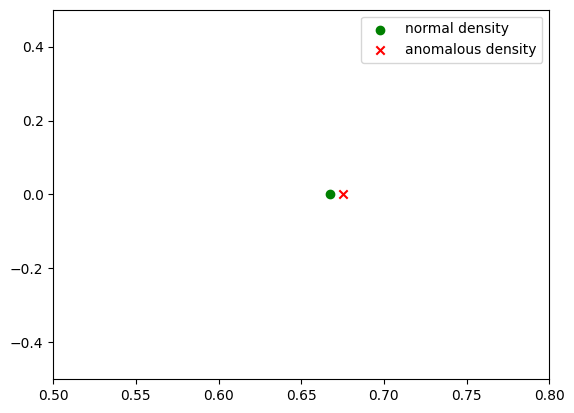

In [ ]:
plt.scatter(x[0], y[0], c="green", marker="o", label="normal density")
plt.scatter(x[1], y[1], c="red", marker="x", label="anomalous density")

plt.xlim(0.5,0.8)
plt.ylim(-0.5,0.5)
plt.legend()
plt.show()

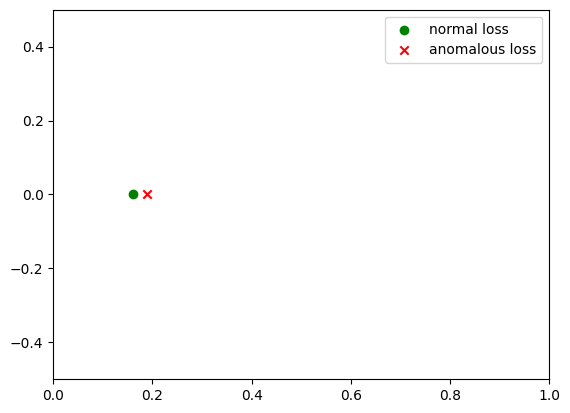

In [ ]:
plt.scatter(x[2], y[2], c="green", marker="o", label="normal loss")
plt.scatter(x[3], y[3], c="red", marker="x", label="anomalous loss")
plt.xlim(0,1)
plt.ylim(-0.5,0.5)
plt.legend()
plt.show()

### Threshold

In order to choose the best threshold both for density and loss the following function is applied and tries out different threshold values. At the end the threshold value returning the biggest number of correct classification is saved.

In [ ]:
def define_thresholds(loader, anomalous_label, avg_dens, avg_loss):
  thresholds = [0.1, 0.01, 0.001, 0.0001]
  corrects = []

  for t in thresholds:
    correct = 0
    for batch_idx, (data, targets) in enumerate(loader):
      count = 0
      for i in range(0, loader.batch_size-1):
        if targets[count].item() == anomalous_label:    # anomalous sample
          x = data[count]
          embedding = e(x)
          z = embedding.detach().numpy()
          z = z.reshape(-1,1)
          reco = d(embedding)
          loss = F.mse_loss(reco, x)
          kde = KernelDensity(kernel="gaussian", bandwidth=0.2).fit(z)
          den = kde.score_samples(z)[0]
          if abs(den-avg_dens[0])>=t and abs(loss.detach().numpy()-avg_loss[0])>=t:
            correct += 1        # anomalous condition satisfied
        else:
          x = data[count]
          embedding = e(x)
          z = embedding.detach().numpy()
          z = z.reshape(-1,1)
          reco = d(embedding)
          loss = F.mse_loss(reco, x)
          kde = KernelDensity(kernel="gaussian", bandwidth=0.2).fit(z)
          den = kde.score_samples(z)[0]
          if abs(den-avg_dens[1])>=t and abs(loss.detach().numpy()-avg_loss[1])>=t:
            correct += 1
    corrects.append(correct)

  max_corrects = max(corrects)
  max_index = corrects.index(max_corrects)

  return thresholds[max_index]

In [ ]:
avg_den = [normal_avg_density, anomalous_avg_density]
avg_loss = [normal_avg_loss, anomalous_avg_loss]
threshold = define_thresholds(val_loader, 5, avg_den, avg_loss)

In [ ]:
print("Defined threshold set to: ", threshold)

Defined threshold set to:  0.0001


## Results

Let's define as 1 the Anomalous Samples and as 0 the Normal ones.

This function saves the predictions of anomalous/normal samples and returns y (list of the true labels, 0 or 1), y_score (list of the predicted labels, 0 or 1) and pred, a dictionary containing TP, TN, FP, FN.

In [ ]:
def test(loader, anomalous_label, normal_avg_density, normal_avg_loss, anomalous_avg_density, anomalous_avg_loss, threshold):
  y =[]
  y_score = []
  pred = {"A": [0,0], "N": [0,0]}
  for batch_idx, (data, targets) in enumerate(loader):
    count = 0
    for i in range(0, loader.batch_size-1):
      x = data[count]
      embedding = e(x)
      z = embedding.detach().numpy()
      z = z.reshape(-1,1)
      reco = d(embedding)
      loss = F.mse_loss(reco, x)
      kde = KernelDensity(kernel="gaussian", bandwidth=0.2).fit(z)
      den = kde.score_samples(z)[0]
      if targets[count].item() == anomalous_label:
        y.append(1)           # anomalous label
        if abs(den-normal_avg_density) >= threshold and abs(loss.detach().numpy()-normal_avg_loss)>= threshold:
          y_score.append(1)   # predicted anomalous
          pred["A"][0] += 1
        else:
          y_score.append(0)   # predicted normal
          pred["A"][1] += 1
      else:
        y.append(0)             # normal label
        if abs(den-anomalous_avg_density) >= threshold and abs(loss.detach().numpy()-anomalous_avg_loss) >= threshold:
          y_score.append(0)     # predicted normal
          pred["N"][0] += 1
        else:
          y_score.append(1)     # predicted anomalous
          pred["N"][1] += 1

      if count+1 < len(data):
        count+=1
      else:
        break
  return y, y_score, pred

In [ ]:
y, y_score, pred = test(test_loader, 5, normal_avg_density, normal_avg_loss, anomalous_avg_density, anomalous_avg_loss, threshold=threshold)

### Metrics

This first function "metrics" TP, FP, TN, FN values are provided.

Let's recall:


*   TP: anomalous classified as anomalous
*   FP: normal classified as anomalous
*   TN: normal classified as normal
*   FN: anomalous classified as normal





In [ ]:
def metric_values(pred):
  n_anomalies = (pred["A"][0])+(pred["A"][1])
  TP = pred["A"][0]/n_anomalies
  FP = pred["A"][1]/n_anomalies
  n_normal = pred["N"][0]+pred["N"][1]
  TN = pred["N"][0]/n_normal
  FN = pred["N"][1]/n_normal

  return TP, FP, TN, FN

In [ ]:
TP, FP, TN, FN = metric_values(pred)

With TP, FP, TN, FN values we can calculate:

*  Accuracy: (TP+TN)/(TP+TN+FP+FN)
*  Recall: TP/(TP+FN)
*  Precision: TP/(TP+FP)
*  F1-score: (Precision * Recall) / (Precision + Recall)




In [ ]:
acc = (TP+TN)/(TP+TN+FP+FN)
recall =  TP/(TP+FN)
precision = TP/(TP+FP)
f1 = (precision * recall) / (precision + recall)

print("Accuracy: ", acc)
print("Recall: ", recall)
print("Precision: ", precision)
print("F1-Score: ", f1)

Accuracy:  0.994088163323869
Recall:  0.9892864901214036
Precision:  0.9989949748743718
F1-Score:  0.4970585149746326


The confusion matrix just sum up the TP, FP, TN, FN values in a matrix form.

In [ ]:
def cm_plot(y, y_score):
  cm = metrics.confusion_matrix(y, y_score)
  disp = metrics.ConfusionMatrixDisplay(confusion_matrix=cm)
  disp.plot()
  plt.show()
  return

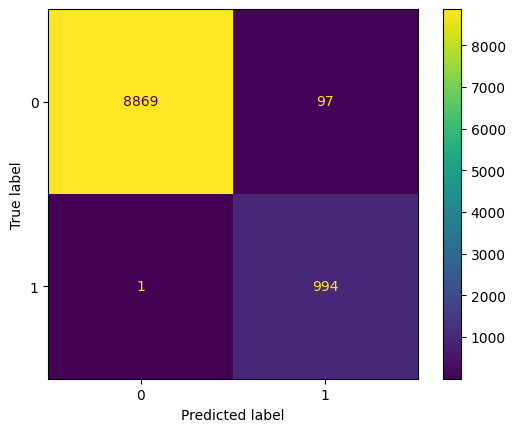

In [ ]:
cm_plot(y, y_score)

The (desired metric) ROC curve (receiver operating characteristic curve) is a graph showing the performance of a classification model at all classification thresholds.

In [ ]:
def roc_curve_plot(y, y_score):
  fpr, tpr, thresholds = metrics.roc_curve(y, y_score)
  roc_auc = metrics.auc(fpr, tpr)
  display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc)
  display.plot()
  return

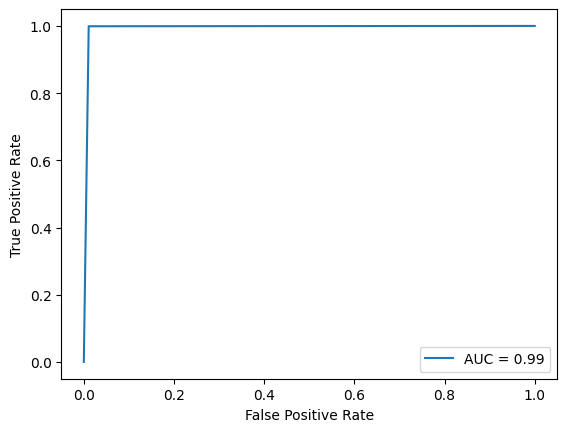

In [ ]:
roc_curve_plot(y, y_score)

# Baseline 2: Variational Autoencoder

The second baseline proposed uses the Variational Autoencoder (VAE) to detect anomalies on the fashionMNIST dataset.

Such as the AE architecture does, VAE consists in encoder and decoder branches.

VAE architeture provides a method for jointly learning deep latent-variable models and corresponding inference models using stochastic gradient descent.

The key concepts used and implemented are derived from the paper ["Auto-Encoding Variational Bayes"](https://arxiv.org/pdf/1312.6114.pdf).


## Normal and Anomal Dataset

In this approach we distinguish the normal dataset (from the anomalous dataset) on which we'll perform training and validation.

As before, the class choosen to be anomalous is the "sandals" class (label n.5).

The test set contains both anomalous and normal samples.

In [ ]:
anomal_data = []
normal_data = []
ANOMALOUS_LABEL = 5

In [ ]:
for i in range(len(dataset)):
  label = dataset[i][1]
  sample = dataset[i][0].tolist()
  if label == ANOMALOUS_LABEL:
    anomal_data.append(sample)
  else:
    normal_data.append(sample)

In [ ]:
anomal_data = torch.Tensor(anomal_data)
normal_data = torch.Tensor(normal_data)

In [ ]:
n_train, n_val = random_split(normal_data, [50000, 4000])

In [ ]:
n_train_loader = DataLoader(n_train, batch_size=512, shuffle=True)
n_val_loader = DataLoader(n_val, batch_size = 256)
test_loader = DataLoader(test_set, batch_size=1, shuffle=True)

## Probabilistic Convolutional Encoder

The Probabilistic Encoder wants to map the input x into a distribution Q which we want to be as close as possible to the real distribution P which generated data.
We can not directly get P since its computation is intractable.

So, the encoder's aim is to find an (approximated) distribution q_ϕ(z|x), parametrized by ϕ, similar to the (real) distribution p_θ(z|x). This process is also called **Variational** Inference.

Rather than directly outputting values for the latent state as we would in a standard autoencoder, the encoder model of a VAE will output parameters describing a distribution for each dimension in the latent space. Since we're assuming that our prior follows a normal distribution, we'll output two vectors describing the mean and variance of the latent state distributions. If we were to build a true multivariate Gaussian model, we'd need to define a covariance matrix describing how each of the dimensions are correlated. However, we'll make a simplifying assumption that our covariance matrix only has nonzero values on the diagonal, allowing us to describe this information in a simple vector.

From this distribution q_ϕ(z|x) we should sample z, which will feed the decoder.
Since the sampling process is stochastic and backpropagation can't be applied over it, we use a reparametrization trick which suggests that we randomly sample ε from a unit Gaussian, and then shift the randomly sampled ε by the latent distribution's mean μ and scale it by the latent distribution's variance σ.

In formulas:


z = μ + σ * ε, where ε ~ (0,I)


In order to deal with the fact that the network may learn negative values for σ, we'll typically have the network learn log(σ) and exponentiate this value to get the latent distribution's variance.



In [ ]:
class Prob_Encoder(pl.LightningModule):
  def __init__(self, hidden_channels: int, latent_dim: int, img_channels=1, image_size = 28)-> None:
    super().__init__()

    self.conv1 = nn.Conv2d( in_channels = img_channels,
                            out_channels = hidden_channels,
                            kernel_size = 3,
                            stride = 1,
                            padding = 1
                          )
    self.out_conv1 = int(np.floor(image_size - 3 + 2*1)+1)
    self.conv2 = nn.Conv2d( in_channels = hidden_channels,
                            out_channels = hidden_channels*2,
                            kernel_size = 3,
                            stride = 2,
                            padding = 1
                          )
    self.out_conv2 = int(np.floor((self.out_conv1 - 3 + 2*1)/2)+1)

    self.activation = nn.ReLU()

    self.fc_mu = nn.Linear(in_features=hidden_channels*2*self.out_conv2*self.out_conv2 ,
                               out_features=latent_dim)

    self.fc_log_sigma = nn.Linear(
                               in_features=hidden_channels*2*self.out_conv2*self.out_conv2,
                               out_features=latent_dim)

  def forward(self, x: torch.Tensor) -> (torch.Tensor, torch.Tensor):

    x = self.activation(self.conv1(x))
    x = self.activation(self.conv2(x))
    x = x.view(x.shape[0], -1)

    mu = self.fc_mu(x)
    log_sigma = self.fc_log_sigma(x)

    return mu, log_sigma


## Probabilistic Decoder

The Probabilistic Decoder model will then generate a latent vector by sampling from these defined distributions and proceed to develop a reconstruction of the original input.

In [ ]:
class Prob_Decoder(pl.LightningModule):

  def __init__(self,hidden_channels: int, latent_dim: int, img_channels=1, image_size =28 ):
    super().__init__()
    self.out_conv1 = int(np.floor(image_size - 3 + 2*1)+1)
    self.out_conv2 = int(np.floor((self.out_conv1 - 3 + 2*1)/2)+1)
    self.hidden_channels = hidden_channels

    self.fc =   nn.Linear( in_features=latent_dim,
                              out_features= hidden_channels*2 *self.out_conv2*self.out_conv2)

    self.conv2 =  nn.ConvTranspose2d(
                            in_channels=hidden_channels*2,
                            out_channels=hidden_channels,
                            kernel_size=3,
                            stride=2,
                            padding=1,
                            output_padding=1)

    self.conv1 =  nn.ConvTranspose2d(
                            in_channels=hidden_channels,
                            out_channels=img_channels,
                            kernel_size=3,
                            stride=1,
                            padding=1)

    self.activation = nn.ReLU()


  def forward(self, z: torch.Tensor) -> torch.Tensor:

      z = self.activation(self.fc(z))
      z = z.view(z.size(0), self.hidden_channels*2, 14, 14)
      z = self.activation(self.conv2(z))
      z = torch.sigmoid(self.conv1(z))
      return z

## VAE

In [ ]:
class VAE(pl.LightningModule):
    def __init__(self, hidden_channels: int, latent_dim: int, enc_out_dim: int, img_channels=1, beta =1):
        super().__init__()
        self.enc_out_dim =  enc_out_dim
        self.encoder = Prob_Encoder(hidden_channels=hidden_channels,
                               latent_dim=latent_dim, img_channels=img_channels)
        self.decoder = Prob_Decoder(hidden_channels=hidden_channels,
                               latent_dim=latent_dim,img_channels=img_channels)
        self.beta = beta


    def loss_function(recon_x, x, mu, log_sigma, beta):
        recon_loss = F.binary_cross_entropy(recon_x.view(-1,784), x.view(-1,784),  reduction='sum')
        #recon_loss = nn.MSELoss()(recon_x, x)
        KLdiv = -0.5 *torch.sum( 1 + log_sigma - log_sigma.exp() - mu**2 )
        return recon_loss + beta *  KLdiv


    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=1e-4)

    def forward(self, x: torch.Tensor) :
        mu, log_sigma  = self.encoder(x)
        std = torch.exp((log_sigma)*0.5)
        epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
        z = mu + epsilon*std
        x_hat = self.decoder(z)
        return x_hat

    def save_images(self, x, x_hat, name):
        grid_top = make_grid(x, nrow=8, padding=10)
        grid_bottom = make_grid(x_hat, nrow=8, padding = 10)
        grid = torch.cat((grid_top, grid_bottom), 1)
        self.logger.experiment.add_image(name, grid)

    def training_step(self, batch, batch_idx):
        x = batch
        mu, log_sigma  = self.encoder(x)
        std = torch.exp((log_sigma)*0.5)
        epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
        z = mu + epsilon*std
        x_hat = self.decoder(z)

        # reconstruction loss
        recon_loss = F.binary_cross_entropy(x_hat.view(-1,784), x.view(-1,784),  reduction='sum')
        # kl
        kl =  -0.5 *torch.sum( 1 + log_sigma - log_sigma.exp() - mu**2 )
        # elbo
        elbo =  recon_loss + self.beta * kl

        self.log_dict({
            'elbo_train_loss': elbo,
            'recon_train_loss': recon_loss,
            'kl_divergence': kl,
        })
        return elbo


    def validation_step(self, batch, batch_idx):
        x = batch
        mu, log_sigma  = self.encoder(x)
        std = torch.exp((log_sigma)*0.5)
        epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
        z = mu + epsilon*std
        x_hat = self.decoder(z)
        recon_loss = F.binary_cross_entropy(x_hat.view(-1,784), x.view(-1,784),  reduction='sum')
        loss =  recon_loss
        self.log_dict({
            'val_loss': loss,
        })

        if batch_idx == 0:
          self.save_images(x, x_hat, "validation_input_output")


        return loss

    def test_step(self, batch, batch_idx):
      x, l = batch
      mu, log_sigma  = self.encoder(x)
      std = torch.exp((log_sigma)*0.5)
      epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
      z = mu + epsilon*std
      x_hat = self.decoder(z)
      recon_loss = F.binary_cross_entropy(x_hat.view(-1,784), x.view(-1,784),  reduction='sum')
      loss =  recon_loss

      self.log_dict({
            'test_loss': loss,
        })

      if batch_idx == 0:
          self.save_images(x, x_hat, "test_input_output")

      return loss

In [ ]:
latent_dims = 2
batch_size = 128
hidden_channels=64
learning_rate = 1e-3
beta = 1

In [ ]:
vae = VAE(hidden_channels=hidden_channels, latent_dim=latent_dims, enc_out_dim=14)

## Training, Validating and Testing

In [ ]:
logger = TensorBoardLogger("tb_logs", name="net",log_graph=True )

In [ ]:
trainer = pl.Trainer(max_epochs=100, logger=logger,
                     callbacks=[TQDMProgressBar(refresh_rate=20), EarlyStopping(monitor='val_loss', patience = 3)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer.fit(vae, n_train_loader, n_val_loader)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:615: UserWarning: Checkpoint directory tb_logs/net/version_0/checkpoints exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type         | Params
-----------------------------------------
0 | encoder | Prob_Encoder | 174 K 
1 | decoder | Prob_Decoder | 149 K 
-----------------------------------------
324 K     Trainable params
0         Non-trainable params
324 K     Total params
1.298     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


In [ ]:
trainer.validate(vae, n_val_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │        67465.15625        │
└───────────────────────────┴───────────────────────────┘

[{'val_loss': 67465.15625}]

In [ ]:
trainer.test(vae, test_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │      268.92333984375      │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 268.92333984375}]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir tb_logs/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2090), started 0:18:02 ago. (Use '!kill 2090' to kill it.)

<IPython.core.display.Javascript object>

From the training we can get some useful results:

- sandals, the anomalous class of images, are not reconstructed in the test_step since they don't compare in the training and validation sets.

Let's see an example here (taken from TensorBoard).

The image below are samples of the test set (containing both normal and anomalous samples) and as the red square highlights, the last sample is a sandal (anomalous, in our case of study).




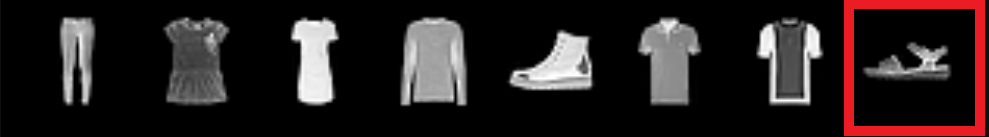

These are the corresponding reconstructions computed by the vae:

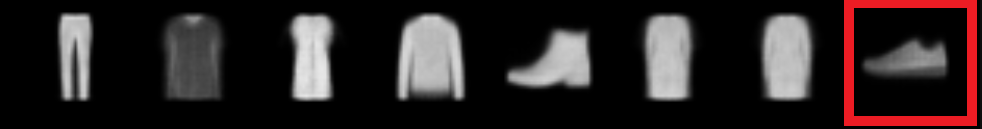

As you can see the results are not so good.

But the most interesting thing to notice for our purposes is that the last (anomalous) sample has been built as a sneaker and not as a sandal, so the loss between the two is expected to be high, more than the other (normal) samples.

## Detecting Anomalies


Following this approach, to detect anomalies the elbo loss will be used.

The intuition behind it is considering the loss as "high" if the sample is anomalous (which pattern has never been seen during training and validation).
To know how much it is high we should compare it to the normal elbo loss.

### Prob Encoder and Prob Decoder instances

In [ ]:
state = deepcopy(vae.state_dict())
print(state.keys())

odict_keys(['encoder.conv1.weight', 'encoder.conv1.bias', 'encoder.conv2.weight', 'encoder.conv2.bias', 'encoder.fc_mu.weight', 'encoder.fc_mu.bias', 'encoder.fc_log_sigma.weight', 'encoder.fc_log_sigma.bias', 'decoder.fc.weight', 'decoder.fc.bias', 'decoder.conv2.weight', 'decoder.conv2.bias', 'decoder.conv1.weight', 'decoder.conv1.bias'])


In [ ]:
e_c1_w = state["encoder.conv1.weight"]
e_c1_b = state["encoder.conv1.bias"]
e_c2_w = state["encoder.conv2.weight"]
e_c2_b = state["encoder.conv2.bias"]
e_mu_w = state["encoder.fc_mu.weight"]
e_mu_b = state["encoder.fc_mu.bias"]
e_log_w = state["encoder.fc_log_sigma.weight"]
e_log_b = state["encoder.fc_log_sigma.bias"]

pe = Prob_Encoder(hidden_channels, latent_dims, 1, 28)

pe.conv1.weight.fill_ = e_c1_w
pe.conv1.bias.fill_ = e_c1_b

pe.conv2.weight.fill_ = e_c2_w
pe.conv2.bias.fill_ = e_c2_b

pe.fc_mu.weight.fill_ = e_mu_w
pe.fc_mu.bias.fill_ = e_mu_b

pe.fc_log_sigma.weight.fill_ = e_log_w
pe.fc_log_sigma.bias.fill_ = e_log_b

In [ ]:
d_fc_w = state['decoder.fc.weight']
d_fc_b = state['decoder.fc.bias']

d_c2_w = state['decoder.conv2.weight']
d_c2_b = state['decoder.conv2.bias']

d_c1_w = state['decoder.conv1.weight']
d_c1_b = state['decoder.conv1.bias']

pd = Prob_Decoder(hidden_channels, latent_dims, 1, 28)

pd.fc.weight.fill_ = d_fc_w
pd.fc.bias.fill_ = d_fc_b

pd.conv2.weight.fill_ = d_c2_w
pd.conv2.bias.fill_ = d_c2_b

pd.conv1.weight.fill_ = d_c1_w
pd.conv1.bias.fill_ = d_c1_b


### Normal and Anomal Losses: BCE

In [ ]:
def normal_loss(loader):
  count = 0
  n_loss = []
  an_loss = []
  for batch_idx, (data, targets) in enumerate(loader):
    mu, log = pe(data)
    std = torch.exp((log)*0.5)
    epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
    z = mu + epsilon*std
    x_hat = pd(z)
    loss = F.binary_cross_entropy(data, x_hat)
    if targets != ANOMALOUS_LABEL:
      n_loss.append(loss.detach().numpy().item())
    else:
      an_loss.append(loss.detach().numpy().item())
  return n_loss, an_loss

In [ ]:
n_loss, an_loss = normal_loss(test_loader)

### Threshold

In [ ]:
avg_normal_loss = np.average(n_loss)
avg_an_loss = np.average(an_loss)
an_threshold = avg_normal_loss
n_threshold = avg_an_loss

## Results

In [ ]:
def testing(loader, an_threshold, n_threshold):
  y=[]
  y_score=[]
  pred = {"A": [0,0], "N": [0,0]}
  for batch_idx, (data, targets) in enumerate(loader):
    mu, log = pe(data)
    std = torch.exp((log)*0.5)
    epsilon = torch.normal(torch.zeros_like(std), torch.ones_like(std))
    z = mu + epsilon*std
    x_hat = pd(z)
    loss = F.binary_cross_entropy(data, x_hat)
    if targets == ANOMALOUS_LABEL:
      y.append(1)
      if loss > an_threshold:
        y_score.append(1)
        pred["A"][0] += 1
      else:
        y_score.append(0)
        pred["A"][1] += 1
    else:
      y.append(0)
      if loss <= n_threshold:
        y_score.append(0)
        pred["N"][0] += 1
      else:
        y_score.append(1)
        pred["A"][1] += 1
  return y, y_score, pred

In [ ]:
t_loader = DataLoader(test_set, batch_size=1, shuffle=True)

In [ ]:
y, y_score, pred = testing(test_loader, an_threshold, n_threshold)

### Metrics

In [ ]:
TP, FP, TN, FN = metric_values(pred)

In [ ]:
acc = (TP+TN)/(TP+TN+FP+FN)
recall =  TP/(TP+FN)
precision = TP/(TP+FP)
f1 = (precision * recall) / (precision + recall)

print("Accuracy: ", acc)
print("Recall: ", recall)
print("Precision: ", precision)
print("F1-Score: ", f1)

Accuracy:  0.7490946714950854
Recall:  1.0
Precision:  0.4981893429901707
F1-Score:  0.33252762430939226


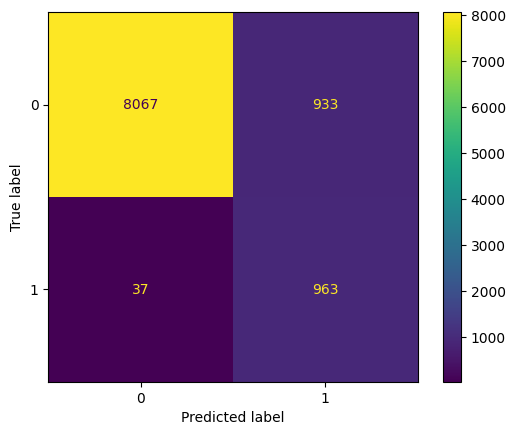

In [ ]:
cm_plot(y, y_score)

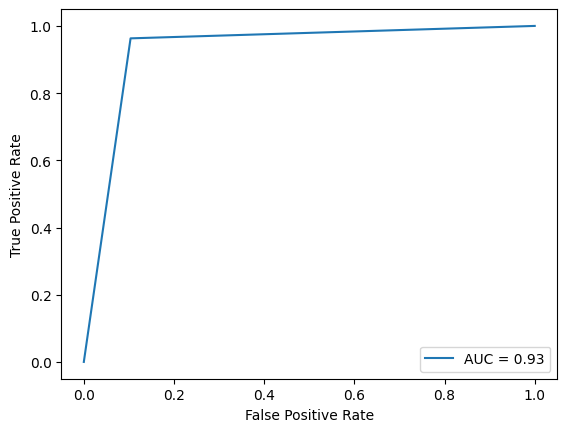

In [ ]:
roc_curve_plot(y, y_score)

# SOTA Algorithm

# References

[1]: [Robust Anomaly Detection in Images using
Adversarial Autoencoders](https://ecmlpkdd2019.org/downloads/paper/581.pdf)

[2]: [Auto-Encoding Variational Bayes](https://arxiv.org/pdf/1312.6114.pdf)